# Effect of vehicles population renewal on NOx concentrations: MODEL WITH CATEGORIES
$$
y_{i,t} = \rho y_{i,t-1} + \sum_{k=1}^{P} \beta_{k,c} x_{i,t,k} + w_i + \epsilon_{i,t}
$$

where:

- $y_{i,t}$ represents the observed response variable at station $i$ and time $t$.  
- $\rho$ is the autoregressive coefficient capturing temporal dependencies.  
- $\beta_{k,c}$ are the regression coefficients, which vary across station categories $c$.  
- $x_{i,t,k}$ represents the $P$ covariates influencing the response.  
- $w_i$ is the station-level spatial effect.  
- $\epsilon_{i,t}$ is the observation noise.  

The model is estimated over:

- $t = 1 - 309$ weeks  
- $i = 1 - 83$ stations  
- $c = 1,2,3$, representing the station type:  
  - $c = 1 \to$ rural station  
  - $c = 2 \to$ urban station  
  - $c = 3 \to$ suburban station  
- $P = 8$ covariates  

The covariates include:

- $k = 1, \dots, 7$: meteorological covariates.  
- $k = 8$: categorical covariate indicating station type.  

By allowing $\beta_{k,c}$ to vary across station types, the model captures the differential effects of meteorological and categorical covariates on pollution levels in rural, urban, and suburban environments.


Libraries

In [ ]:
import sys
import os
import arviz as az
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd


# Stan
import cmdstanpy
from cmdstanpy import install_cmdstan
cmdstanpy.install_cmdstan()
from cmdstanpy import CmdStanModel
from scipy.spatial.distance import pdist

#from tensorflow_probability.substrates import numpy as tfp
#tfd = tfp.distributions

# Libraries for the map
from pyproj import Proj, transform
import folium
from matplotlib import colors

Load data and visualize

In [ ]:

df = pd.read_excel('output_file.xlsx')
df = df.sort_values(by=['sensor_id', 'Settimana'])
stations = pd.read_excel('weeklydataset2.xlsx')

In [ ]:
df.head(5)


,Utm_Nord,sensor_id,Settimana,temperature_2m_mean,precipitation_sum,precipitation_hours,sunshine_duration,daylight_duration,wind_speed_10m_max,et0_fao_evapotranspiration,Valore,Comune,UTM_Est,lat,lng,TIPO_EOI
42,5040815,6204.0,2018-01-01,4.349143,1.200000,4.428571,15800.095857,31793.244857,13.754136,0.570685,87.998240,Treviglio,546236.0,45.519335,9.592019,UT
127,5040815,6204.0,2018-01-08,6.174143,2.742857,5.142857,18293.086429,32365.938000,15.510893,0.640740,90.695833,Treviglio,546236.0,45.519335,9.592019,UT
212,5040815,6204.0,2018-01-15,3.150036,0.457143,1.857143,27187.993857,33135.910143,12.865133,0.862840,103.585714,Treviglio,546236.0,45.519335,9.592019,UT
297,5040815,6204.0,2018-01-22,4.564321,0.357143,2.285714,18821.623857,34049.212429,10.050846,0.694678,120.221429,Treviglio,546236.0,45.519335,9.592019,UT
382,5040815,6204.0,2018-01-29,5.357476,1.300000,5.714286,11508.773200,35105.069571,9.986021,0.616823,87.173810,Treviglio,546236.0,45.519335,9.592019,UT


Sizes of the dataset

In [ ]:
id = df['sensor_id']
N = len(np.unique(id))
weeks = df['Settimana']
T = len(np.unique(weeks))
print(N,T)


86 315


Clean the dataset

In [ ]:

stats = stations[['sensor_id']].drop_duplicates()  #Stations under study

df = pd.merge(df,stats,on='sensor_id') # Filter only the stations into study
coords = df[['UTM_Est','Utm_Nord']].drop_duplicates() #Create the coordinates matrix
print(coords)

        UTM_Est  Utm_Nord
0      546236.0   5040815
314    543342.0   5053519
628    547691.0   5052072
942    550116.0   5059922
1256   551482.0   5060449
...         ...       ...
25120  538586.0   5084478
25434  598141.0   5040227
25748  594556.0   5043948
26062  591371.0   5080789
26376  593101.0   5040636

[85 rows x 2 columns]


We get rid of two stations with many NA and handle other stations NAs by taking the previous value :

In [ ]:
for i in df[df['Valore'].isna()].index:
    if df.at[i,'sensor_id']==df.at[i-1,'sensor_id']:
        df.at[i,'Valore']= df.at[i-1,'Valore']

df = df[~df['sensor_id'].isin([20489, 20493])] # STations with too many missing values

df = df[df['Settimana'] >= '2018-02-05']  # Many NAs In January of the forst year

print(df.shape)
print(len(np.unique(df['sensor_id'])))

(25647, 16)
83


In [ ]:
print(  df[df['Valore'].isna()].drop_duplicates()) #Check that we have no more NAs
print('finall dataset shape : ', df.shape)
print('final number of stations : ',len(np.unique(df['sensor_id'])))
print('final number of time stamps : ',df.shape[0]/len(np.unique(df['sensor_id'])))

Empty DataFrame
Columns: [Utm_Nord, sensor_id, Settimana, temperature_2m_mean, precipitation_sum, precipitation_hours, sunshine_duration, daylight_duration, wind_speed_10m_max, et0_fao_evapotranspiration, Valore, Comune, UTM_Est, lat, lng, TIPO_EOI]
Index: []
finall dataset shape :  (25647, 16)
final number of stations :  83
final number of time stamps :  309.0


Create matrixes of target variable and covariates

In [ ]:
print(df)
print(df['TIPO_EOI'].isna)

       Utm_Nord  sensor_id  Settimana  temperature_2m_mean  precipitation_sum  \
5       5040815     6204.0 2018-02-05             4.361940           3.228571   
6       5040815     6204.0 2018-02-12             2.867893           0.514286   
7       5040815     6204.0 2018-02-19             3.398250           2.342857   
8       5040815     6204.0 2018-02-26            -1.352643           3.042857   
9       5040815     6204.0 2018-03-05             6.578309           6.828572   
...         ...        ...        ...                  ...                ...   
26685   5040636    30162.0 2023-12-04             3.041226           1.271429   
26686   5040636    30162.0 2023-12-11             5.338547           1.300000   
26687   5040636    30162.0 2023-12-18             8.374262           0.000000   
26688   5040636    30162.0 2023-12-25             7.806107           2.800000   
26689   5040636    30162.0 2024-01-01             5.792417           0.000000   

       precipitation_hours 

In [ ]:
# Here we create the lables for Rural Urban and Suburban

def one_hot_encode_types(df, column):
    df[column] = df[column].fillna('')
    unique_chars = sorted(set(''.join(df[column].unique())))
    for char in unique_chars:
        df[char] = df[column].apply(lambda x: 1 if char in x else 0)
    return df

df_encoded = one_hot_encode_types(df, 'TIPO_EOI')
def label_encode_types(df, column):
    df[column] = df[column].fillna('')
    df['station_type'] = df[column].apply(lambda x: x[0] if len(x) > 0 else '')

    # Map 'R', 'U', 'S' to 0, 1, 2
    mapping = {'R': 1, 'U': 2, 'S': 3}
    df['station_type'] = df['station_type'].map(mapping).fillna(1).astype(int)

    return df

df_encoded = label_encode_types(df, 'TIPO_EOI')
print(df_encoded)

       Utm_Nord  sensor_id  Settimana  temperature_2m_mean  precipitation_sum  \
5       5040815     6204.0 2018-02-05             4.361940           3.228571   
6       5040815     6204.0 2018-02-12             2.867893           0.514286   
7       5040815     6204.0 2018-02-19             3.398250           2.342857   
8       5040815     6204.0 2018-02-26            -1.352643           3.042857   
9       5040815     6204.0 2018-03-05             6.578309           6.828572   
...         ...        ...        ...                  ...                ...   
26685   5040636    30162.0 2023-12-04             3.041226           1.271429   
26686   5040636    30162.0 2023-12-11             5.338547           1.300000   
26687   5040636    30162.0 2023-12-18             8.374262           0.000000   
26688   5040636    30162.0 2023-12-25             7.806107           2.800000   
26689   5040636    30162.0 2024-01-01             5.792417           0.000000   

       precipitation_hours 

In [ ]:
y = df.pivot_table(index='sensor_id', columns='Settimana', values='Valore')

print(y.shape)


(83, 309)


In [ ]:
#Normalization NOX quantity
y_normalized = np.zeros_like(y.values)
for i in range(y.shape[0]):
    y_mean = y.iloc[i, :].mean()
    y_std = y.iloc[i, :].std()
    y_normalized[i, :] = (y.iloc[i, :] - y_mean) / y_std


y_normalized = pd.DataFrame(y_normalized, index=y.index, columns=y.columns)

print(f"y_normalized shape: {y_normalized.shape}")


y_normalized shape: (83, 309)


In [ ]:
#List ov covariates
covariate_list = ["temperature_2m_mean", "daylight_duration", "precipitation_sum", "et0_fao_evapotranspiration", "precipitation_hours","wind_speed_10m_max","sunshine_duration","station_type"]

# Filter the variables of interest
df_covariate = df[covariate_list]

print(df_covariate["station_type"].value_counts())


station_type
2    15759
3     5562
1     4326
Name: count, dtype: int64


In [ ]:
#Normalization covariates
x = []
for covariate in covariate_list:
    matrix_2d = df.pivot_table(index='sensor_id', columns='Settimana', values=covariate)
    x.append(matrix_2d.values)
x = np.array(x)
x = x.transpose(1, 2, 0)
x_normalized = np.zeros_like(x)

for i in range(x.shape[0]):
    for p in range(x.shape[2]-1):
        x_mean = x[i, :, p].mean()
        x_std = x[i, :, p].std()
        x_normalized[i, :, p] = (x[i, :, p] - x_mean) / x_std
    for p in range(x.shape[2]-1, x.shape[2]):
        x_normalized[i, :, p] = x[i, :, p].astype(int)

print(f"x_normalized shape: {x_normalized.shape}")
print(x_normalized[:,1,7])


x_normalized shape: (83, 309, 8)
[2. 2. 3. 2. 2. 3. 3. 2. 2. 3. 2. 2. 1. 2. 2. 3. 2. 3. 3. 2. 2. 2. 2. 2.
 2. 3. 2. 2. 2. 2. 2. 2. 2. 2. 3. 1. 2. 2. 1. 2. 3. 3. 2. 2. 2. 2. 2. 1.
 2. 3. 3. 2. 1. 2. 2. 1. 2. 2. 2. 2. 3. 1. 2. 3. 2. 3. 3. 1. 2. 2. 2. 2.
 2. 2. 1. 2. 1. 1. 1. 2. 1. 3. 1.]


In [ ]:
coords = coords[~coords['UTM_Est'].isin([598141, 594556])]
coords=coords/1000
print(coords)

       UTM_Est  Utm_Nord
0      546.236  5040.815
314    543.342  5053.519
628    547.691  5052.072
942    550.116  5059.922
1256   551.482  5060.449
...        ...       ...
24492  521.452  5049.780
24806  492.461  4994.371
25120  538.586  5084.478
26062  591.371  5080.789
26376  593.101  5040.636

[83 rows x 2 columns]


In [ ]:
#MAX DISTANCE
coords_km = coords[['UTM_Est', 'Utm_Nord']]

# Compute pairwise Euclidean distances
distances = pdist(coords_km, metric='euclidean')

# Find the maximum distance
max_distance_km = max(distances)
print(f"Maximum distance between two stations: {max_distance_km:.2f} km")


Maximum distance between two stations: 205.61 km


#STAN MODEL
In the following we implement the AR(1) already introduced before in STAN.
\
The general setting is quite similar to the one without categories. The attention has to be focused in the generated quantities were the beta vector changes for each type of station.

In [ ]:
import cmdstanpy
causal_code = """
data {
  int<lower=1> N;             // Number of stations
  int<lower=1> T;             // Number of time steps (weeks)
  int<lower=1> P;             // Number of covariates
  int<lower=1> T0;            // Last time step before intervention
  int<lower=1> K;             // Number of station types
  matrix[N, 2] coords;        // Geographic coordinates of stations
  matrix[N, T] y_obs;         // Observed concentrations (output)
  array[N, T] vector[P] x;    // Atmospheric covariates
  array[N] int<lower=1, upper=K> station_type; // Station type as categorical variable
  real<lower=0> a;            // Shape parameter for InvGamma
  real<lower=0> b;            // Scale parameter for InvGamma
}

parameters {
  real<lower=0> rho_w;        // Spatial scale of GP
  real<lower=0> sigma;        // Noise standard deviation
  real rho;                   // Autoregressive coefficient
  matrix[K, P] beta;          // Covariate coefficients by station type
  vector[N] w;                // Spatial effects
}

transformed parameters {
  cov_matrix[N] Sigma_w;       // Spatial covariance matrix
  for (i in 1:N) {
    for (j in 1:N) {
      Sigma_w[i, j] = exp(-squared_distance(coords[i], coords[j]) / (2 * (rho_w)^2));
    }
  }
  for (i in 1:N) {
    Sigma_w[i, i] += 1e-6;
    }
}

model {
  // Priors
  rho ~ normal(0, 1);                  // Prior for autoregressive coefficient
  to_vector(beta) ~ normal(0, 1);      // Prior for covariate coefficients
  sigma ~ inv_gamma(a, b);             // Prior for noise standard deviation
  rho_w ~ normal(10, 1) T[0,];        // Prior for spatial correlation
  w ~ multi_normal(rep_vector(0, N), Sigma_w);  // GP for spatial effects

  // Likelihood: Pre-intervention period
  for (t in 2:T0) {
    vector[N] covariate_effect;
    for (i in 1:N) {
      covariate_effect[i] = dot_product(x[i, t], to_vector(beta[station_type[i], :]));  // Different beta per station type
    }
    y_obs[, t] ~ normal(rho * y_obs[, t - 1] + covariate_effect + w, sigma);
  }
}

generated quantities {
  matrix[N, T - T0] y_sim; // Counterfactual predictions
  matrix[N, T - T0] impact;           // Pointwise impact
  vector[T - T0] cumulative_impact;   // Cumulative impact
  matrix[N, T0] log_lik;              // Log-likelihood

  // Compute log-likelihood
  for (i in 1:N) {
    log_lik[i, 1] = 0;
  }
  for (t in 2:T0) {
    vector[N] covariate_effect;
    for (i in 1:N) {
      covariate_effect[i] = dot_product(x[i, t], to_vector(beta[station_type[i], :]));
    }
    for (i in 1:N) {
      log_lik[i, t] = normal_lpdf(y_obs[i, t] | rho * y_obs[i, t - 1] + covariate_effect[i] + w[i], sigma);
    }
  }

  // Generate simulation and compute impact
  for (i in 1:N) {
    for (t in 1:(T - T0)) {
      real covariate_effect = dot_product(x[i, T0 + t], to_vector(beta[station_type[i], :]));

      if (t == 1) {
        y_sim[i, t] = normal_rng(rho * y_obs[i, T0] + covariate_effect + w[i], sigma);
      } else {
        y_sim[i, t] = normal_rng(rho * y_sim[i, t - 1] + covariate_effect + w[i], sigma);
      }

      // Computation of pointwise impact
      impact[i, t] = y_obs[i, T0 + t] - y_sim[i, t];
    }
  }

  // Compute cumulative impact
  for (t in 1:(T - T0)) {
    cumulative_impact[t] = sum(impact[, t]);
  }
}

"""

# Save the Stan code to a .stan file
causal_file = "causal.stan"
with open(causal_file, "w") as f:
    print(causal_code, file=f)

# Compile Stan model
causal = cmdstanpy.CmdStanModel(stan_file=causal_file)


02:30:32 - cmdstanpy - INFO - compiling stan file C:\Users\loren\ONEDRI~1\Desktop\Bayesian\BAYESP~1\Project\Stan\causal.stan to exe file C:\Users\loren\OneDrive - Politecnico di Milano\Desktop\Bayesian\Bayes Proj\Project\Stan\causal.exe
02:31:05 - cmdstanpy - INFO - compiled model executable: C:\Users\loren\OneDrive - Politecnico di Milano\Desktop\Bayesian\Bayes Proj\Project\Stan\causal.exe


Run and fit of the model.

In [ ]:
T0 = 160


# Stan Data
stan_data = {
    'N': 83,              # N of stations
    'T': 309,             # N of weeks
    'P': 8,               # N of covariates
    'T0': 160,            # Pre-intervention week
    'K':3,
    'coords': coords,
    'y_obs': y_normalized,
    'x': x_normalized,
    'station_type' : x_normalized[:,2,7].astype(int),
    'a': 0.1,
    'b': 0.1
}

model = CmdStanModel(stan_file="causal.stan")
fit = model.sample(data=stan_data, iter_sampling=1000, iter_warmup=2500, chains=2, parallel_chains=2, show_console=True)



02:31:06 - cmdstanpy - INFO - Chain [1] start processing
02:31:06 - cmdstanpy - INFO - Chain [2] start processing


Chain [2] method = sample (Default)
Chain [2] sample
Chain [2] num_samples = 1000 (Default)
Chain [2] num_warmup = 2500
Chain [2] save_warmup = false (Default)
Chain [2] thin = 1 (Default)
Chain [2] adapt
Chain [2] engaged = true (Default)
Chain [2] gamma = 0.05 (Default)
Chain [2] delta = 0.8 (Default)
Chain [2] kappa = 0.75 (Default)
Chain [2] t0 = 10 (Default)
Chain [2] init_buffer = 75 (Default)
Chain [2] term_buffer = 50 (Default)
Chain [2] window = 25 (Default)
Chain [2] save_metric = false (Default)
Chain [2] algorithm = hmc (Default)
Chain [2] hmc
Chain [2] engine = nuts (Default)
Chain [2] nuts
Chain [2] max_depth = 10 (Default)
Chain [2] metric = diag_e (Default)
Chain [2] metric_file =  (Default)
Chain [2] stepsize = 1 (Default)
Chain [2] stepsize_jitter = 0 (Default)
Chain [2] num_chains = 1 (Default)
Chain [2] id = 2
Chain [2] data
Chain [2] file = C:\Users\loren\AppData\Local\Temp\tmph75q_j8r\e8f0b5wq.json
Chain [2] init = 2 (Default)
Chain [2] random
Chain [2] seed = 583

06:10:11 - cmdstanpy - INFO - Chain [2] done processing


Chain [2] 
Chain [2] Elapsed Time: 6068.73 seconds (Warm-up)
Chain [2] 7075.96 seconds (Sampling)
Chain [2] 13144.7 seconds (Total)
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 
Chain [2] 

06:22:31 - cmdstanpy - INFO - Chain [1] done processing
06:22:31 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: causal_model_namespace::log_prob: Sigma_w[1, 1] is nan, but must be not nan! (in 'causal.stan', line 25, column 2 to column 24)
	Exception: causal_model_namespace::log_prob: Sigma_w[1, 1] is nan, but must be not nan! (in 'causal.stan', line 25, column 2 to column 24)
Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'causal.stan', line 50, column 4 to column 76)
	Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'causal.stan', line 50, column 4 to column 76)
	Exception: causal_model_namespace::log_prob: Sigma_w[1, 1] is nan, but must be not nan! (in 'causal.stan', line 25, column 2 to column 24)
	Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'causal.stan', line 50, column 4 to column 76)


Chain [1] 
Chain [1] Elapsed Time: 7612.7 seconds (Warm-up)
Chain [1] 6272.31 seconds (Sampling)
Chain [1] 13885 seconds (Total)
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Chain [1] 
Ch

06:22:40 - cmdstanpy - WARNING - Some chains may have failed to converge.
	Chain 1 had 791 iterations at max treedepth (79.1%)
	Chain 2 had 963 iterations at max treedepth (96.3%)
	Use the "diagnose()" method on the CmdStanMCMC object to see further information.


Post fit analysis

In [ ]:
# Results analysis
posterior = fit.draws_pd()

# Estraction of Simulated and impacts
simulated = posterior.filter(like='y_sim')
impact = posterior.filter(like='impact')
cumulative_impact = posterior.filter(like='cumulative_impact')

print(simulated.mean(axis=0))          # Simulated impact
print(impact.mean(axis=0))             # Punctual impact
print(cumulative_impact.mean(axis=0))  # Comulative impact

y_sim[1,1]       0.897713
y_sim[2,1]       0.828600
y_sim[3,1]       0.450123
y_sim[4,1]       0.748687
y_sim[5,1]       0.582037
                   ...   
y_sim[79,149]    1.330518
y_sim[80,149]    1.733277
y_sim[81,149]    0.804417
y_sim[82,149]    1.195643
y_sim[83,149]    1.331183
Length: 12367, dtype: float64
impact[1,1]                -0.621840
impact[2,1]                -0.475001
impact[3,1]                -0.474478
impact[4,1]                -0.594687
impact[5,1]                -0.390439
                             ...    
cumulative_impact[145]    -13.471276
cumulative_impact[146]      3.925428
cumulative_impact[147]     51.750509
cumulative_impact[148]    -65.174669
cumulative_impact[149]   -161.174857
Length: 12516, dtype: float64
cumulative_impact[1]      -42.375996
cumulative_impact[2]      -58.570470
cumulative_impact[3]      -95.749848
cumulative_impact[4]      -62.365828
cumulative_impact[5]      -62.005389
                             ...    
cumulative_impact[145]   

In [ ]:
# Check the posterior samples
posterior = fit.draws_pd()

# Print a preview
#print(posterior.head())

# Check for NaN values or constant values
print(posterior.isna().sum().sum())  # Count the number of NaN values for each parameter
print(posterior.nunique())  # Number of unique values for each parameter


0


In [ ]:
print(dir(fit))
#print(fit.stan_variable_names())

posterior = fit.stan_variables()

print(posterior.keys())
for key in posterior.keys() :
    print(key,posterior[key].shape)


['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattr__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_assemble_draws', '_check_sampler_diagnostics', '_divergences', '_draws', '_is_fixed_param', '_iter_sampling', '_iter_warmup', '_max_treedepths', '_metadata', '_metric', '_save_warmup', '_sig_figs', '_step_size', '_thin', '_validate_csv_files', 'chain_ids', 'chains', 'column_names', 'diagnose', 'divergences', 'draws', 'draws_pd', 'draws_xr', 'max_treedepths', 'metadata', 'method_variables', 'metric', 'metric_type', 'num_draws_sampling', 'num_draws_warmup', 'runset', 'save_csvfiles', 'stan_variable', 'stan_variables', 'step_size', 'summary', 'thin']
dict_keys(['rho_w', 'sigma', 'rho', 'beta', 'w', 'Sigma_w', 'y_sim',

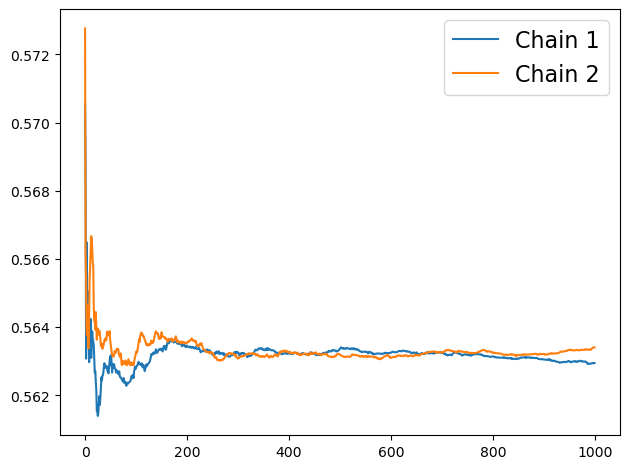

In [ ]:
#Computations of chain
posterior_rho = fit.draws(concat_chains=False)[:, :, fit.column_names.index('rho')]
running_sum = np.cumsum(posterior_rho, axis=0)
running_avg = running_sum / np.arange(1, running_sum.shape[0] + 1)[:, np.newaxis]

for i in range(running_avg.shape[1]):
    plt.plot(running_avg[:, i], label=f"Chain {i+1}")

plt.legend(fontsize=16)
plt.tight_layout()
plt.show()

Processing rho...


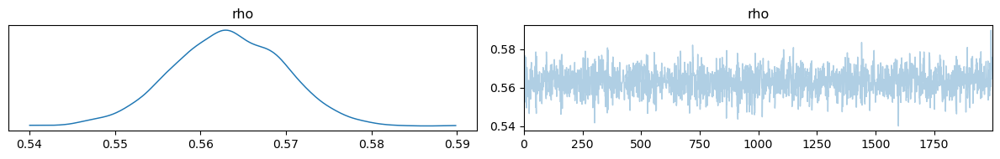

Processing rho_w...


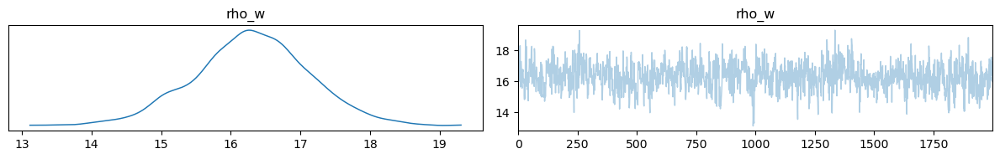

Processing sigma...


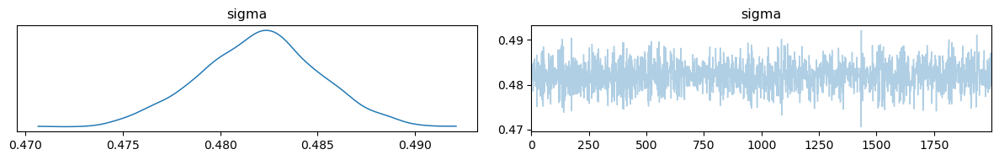

In [ ]:
#LOLLO

import arviz as az
import matplotlib.pyplot as plt
import gc

# Process each variable separately to avoid memory explosion
for var in ["rho", "rho_w", "sigma"]:
    print(f"Processing {var}...")  # Track progress

    # Create an InferenceData object only for the current variable
    dt = az.from_dict(posterior={var: posterior[var]})

    # Plot the trace
    az.plot_trace(dt, var_names=[var], compact=True)  # Use compact=True to reduce memory
    plt.tight_layout()
    plt.show()

    # Free memory after each plot
    del dt
    plt.close("all")
    gc.collect()  # Garbage collection

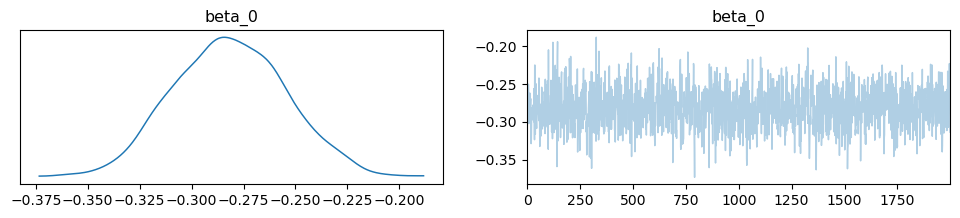

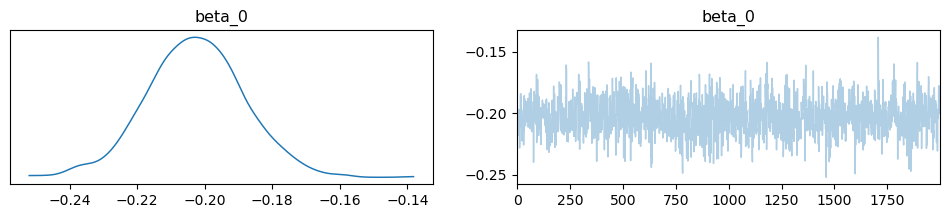

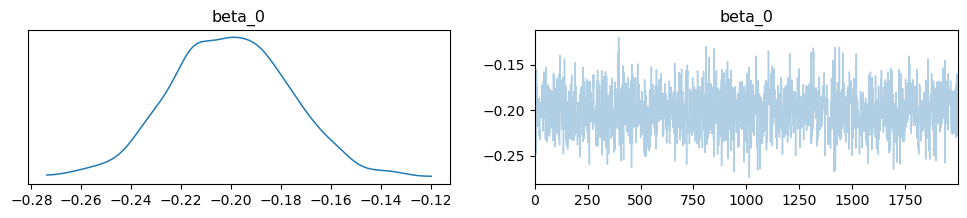

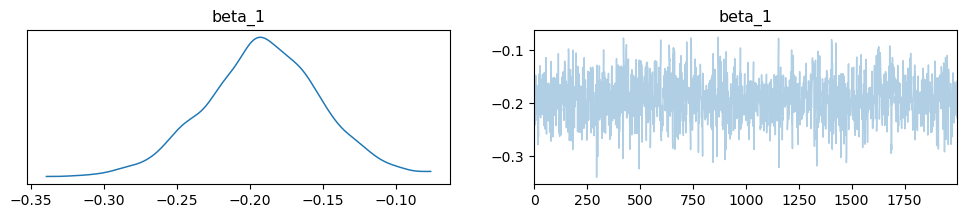

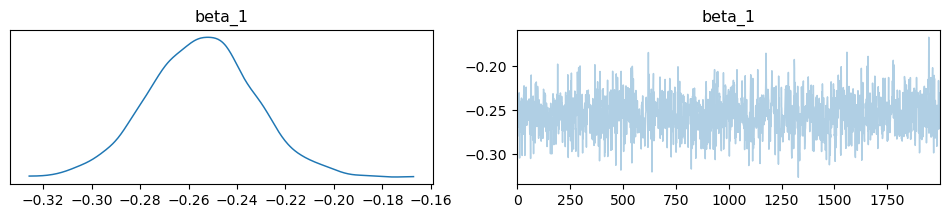

...

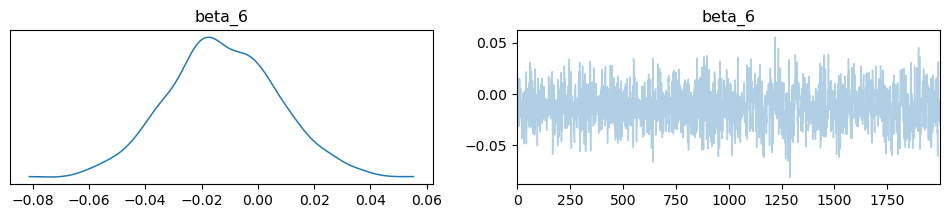

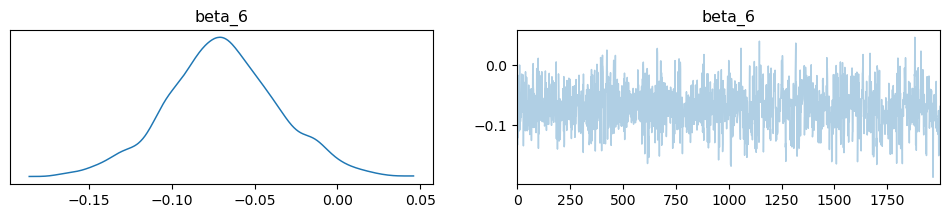

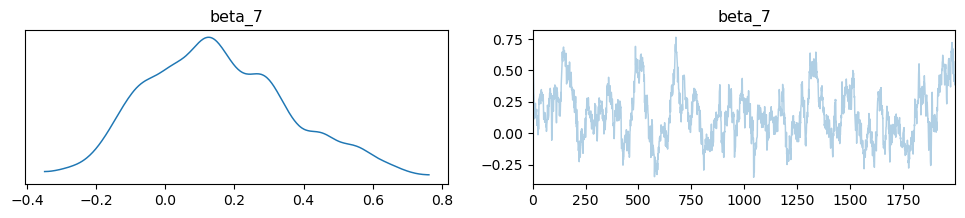

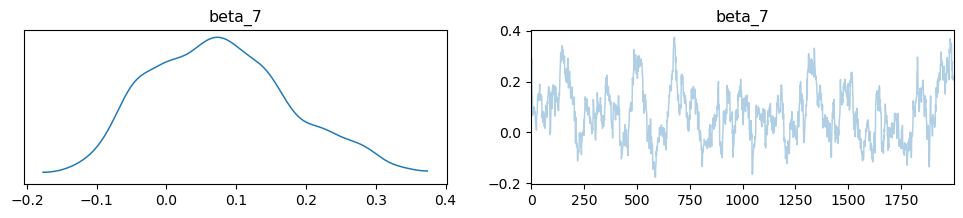

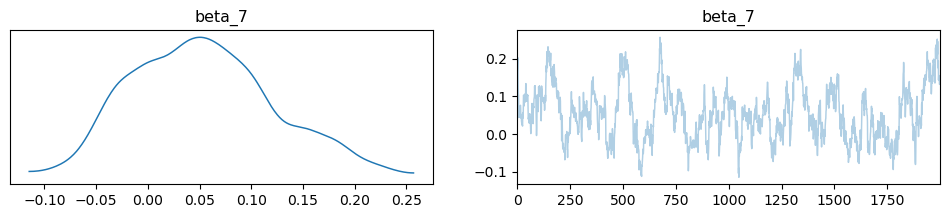

In [ ]:
for i in range(8):
    for k in range(3):
        az.plot_trace(az.from_dict(posterior={f"beta_{i}": fit.stan_variable("beta")[:,k ,i]}), var_names=[f"beta_{i}"])
        plt.show()

#"temperature_2m_mean", "daylight_duration", "precipitation_sum", "et0_fao_evapotranspiration","wind_speed_10m_max","sunshine_duration"


### Credibility Intervals

Now it is time to check for the credibility interval of our betas.
\
First the meteorological covariates subjected to the type of stations.

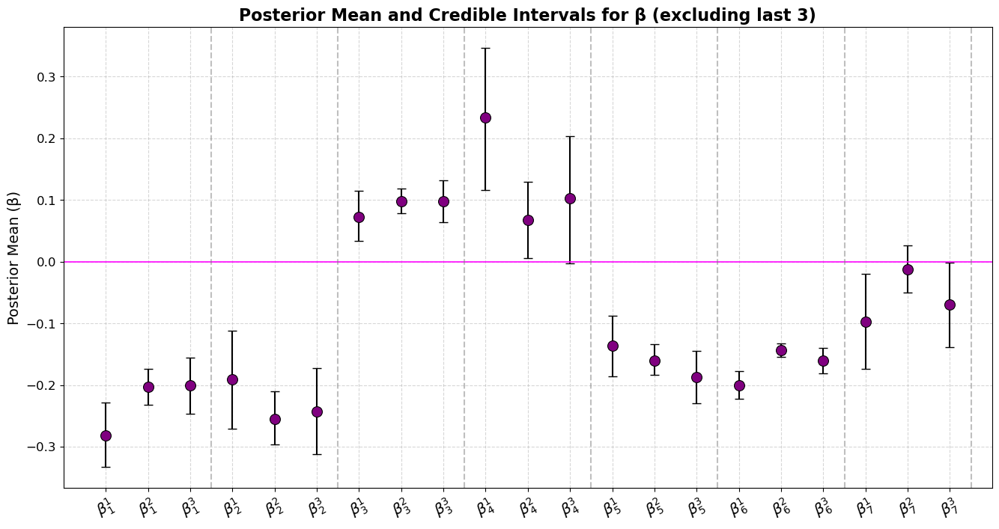

In [ ]:
# 95% CI
mean_beta = np.mean(beta_samples, axis=0)
ci_lower = np.percentile(beta_samples, 2.5, axis=0)
ci_upper = np.percentile(beta_samples, 97.5, axis=0)

num_categories, num_betas = beta_samples.shape[1:]
beta_labels = [rf'$\beta_{{{k+1}}}^{{{j+1}}}$' for k in range(num_betas) for j in range(num_categories)]
mean_beta_flattened = mean_beta.T.flatten()
ci_lower_flattened = ci_lower.T.flatten()
ci_upper_flattened = ci_upper.T.flatten()

df_beta = pd.DataFrame({
    'Parameter': beta_labels,
    'Mean': mean_beta_flattened,
    'CI Lower': ci_lower_flattened,
    'CI Upper': ci_upper_flattened
})

df_main = df_beta.iloc[:-3]
df_last = df_beta.iloc[-3:]

plt.figure(figsize=(16, 8))
sns.scatterplot(x=df_main['Parameter'], y=df_main['Mean'], color="purple", s=100, edgecolor='black', zorder=3)
plt.errorbar(df_main['Parameter'], df_main['Mean'],
             yerr=[df_main['Mean'] - df_main['CI Lower'], df_main['CI Upper'] - df_main['Mean']],
             fmt='none', ecolor='black', capsize=4, zorder=2)
plt.axhline(y=0, color='magenta', linestyle='solid', linewidth=1.5, alpha=0.8)

for i in range(0, len(df_main), 3):
    plt.axvline(x=i + 2.5, color='gray', linestyle='--', alpha=0.5)

plt.xticks(rotation=30, fontsize=14)
plt.yticks(fontsize=12)
plt.ylabel("Posterior Mean (β)", fontsize=14)
plt.xlabel("")
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend([], [], frameon=False)
plt.title("Posterior Mean and Credible Intervals for β (excluding last 3)", fontsize=16, fontweight='bold')

plt.show()


In the following of the incertepts.

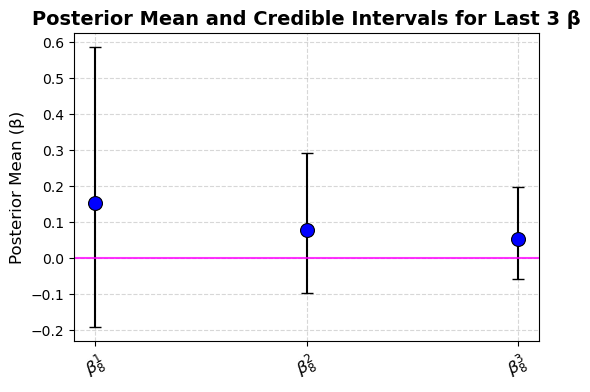

In [ ]:
beta_labels = [rf'$\beta_{{{j+1}}}^{{{k+1}}}$' for k in range(num_betas) for j in range(num_categories)]


plt.figure(figsize=(6, 4))
sns.scatterplot(x=df_last['Parameter'], y=df_last['Mean'], color="blue", s=100, edgecolor='black', zorder=3)
plt.errorbar(df_last['Parameter'], df_last['Mean'],
             yerr=[df_last['Mean'] - df_last['CI Lower'], df_last['CI Upper'] - df_last['Mean']],
             fmt='none', ecolor='black', capsize=4, zorder=2)
plt.axhline(y=0, color='magenta', linestyle='solid', linewidth=1.5, alpha=0.8)

plt.xticks(rotation=30, fontsize=12)
plt.yticks(fontsize=10)
plt.ylabel("Posterior Mean (β)", fontsize=12)
plt.xlabel("")
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend([], [], frameon=False)
plt.title("Posterior Mean and Credible Intervals for Last 3 β", fontsize=14, fontweight='bold')

plt.show()


## Causal Impact Analysis
First we look at our stations in the period of post intervention thanks to a graphical rappresentation (inspired by the one in R implemented in the pack CausalImpact) in which the three images represent respectivly:
1. The real value vs the symulated one, with the uncertainty interval of 0.05%;
2. The point impact, also with uncertainty of 0.05%;
3. The comulative impact, uncertainity of 0.05%.
As we will see the third one is the most relevant to adress the estimation of our impact.

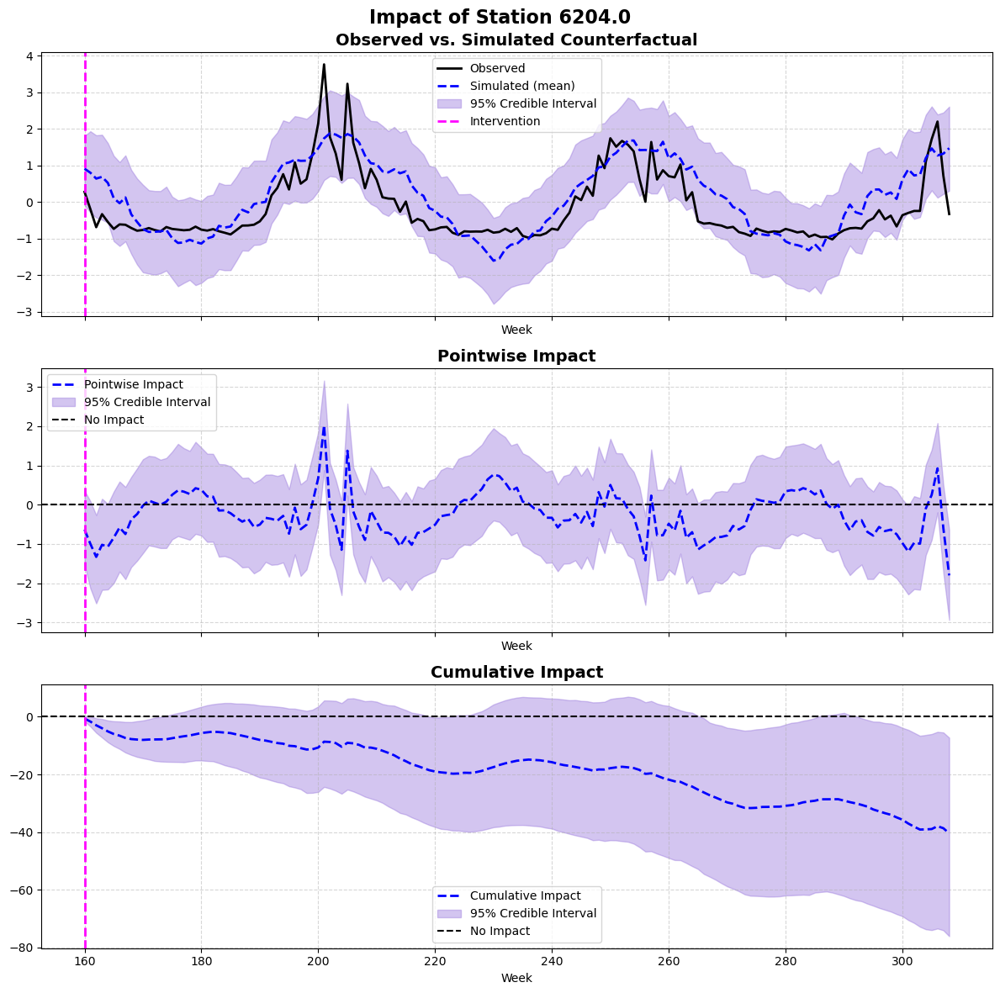

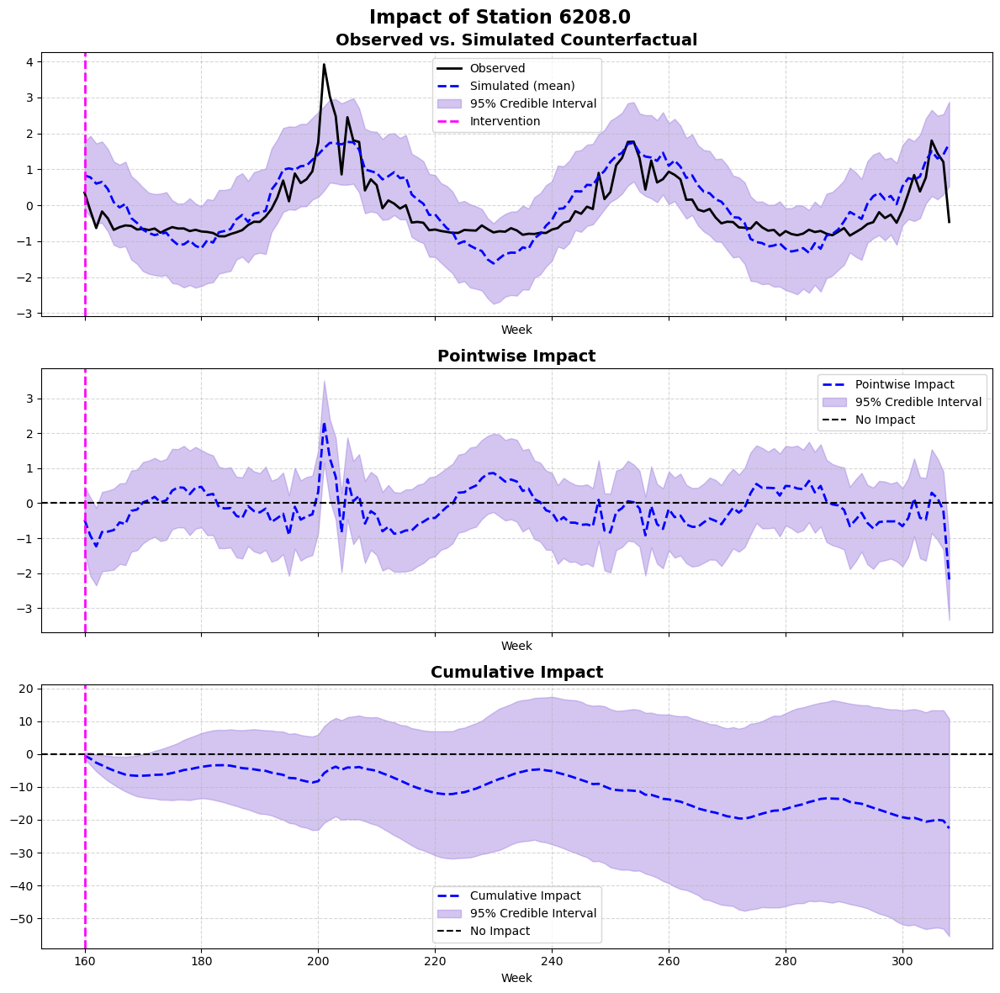

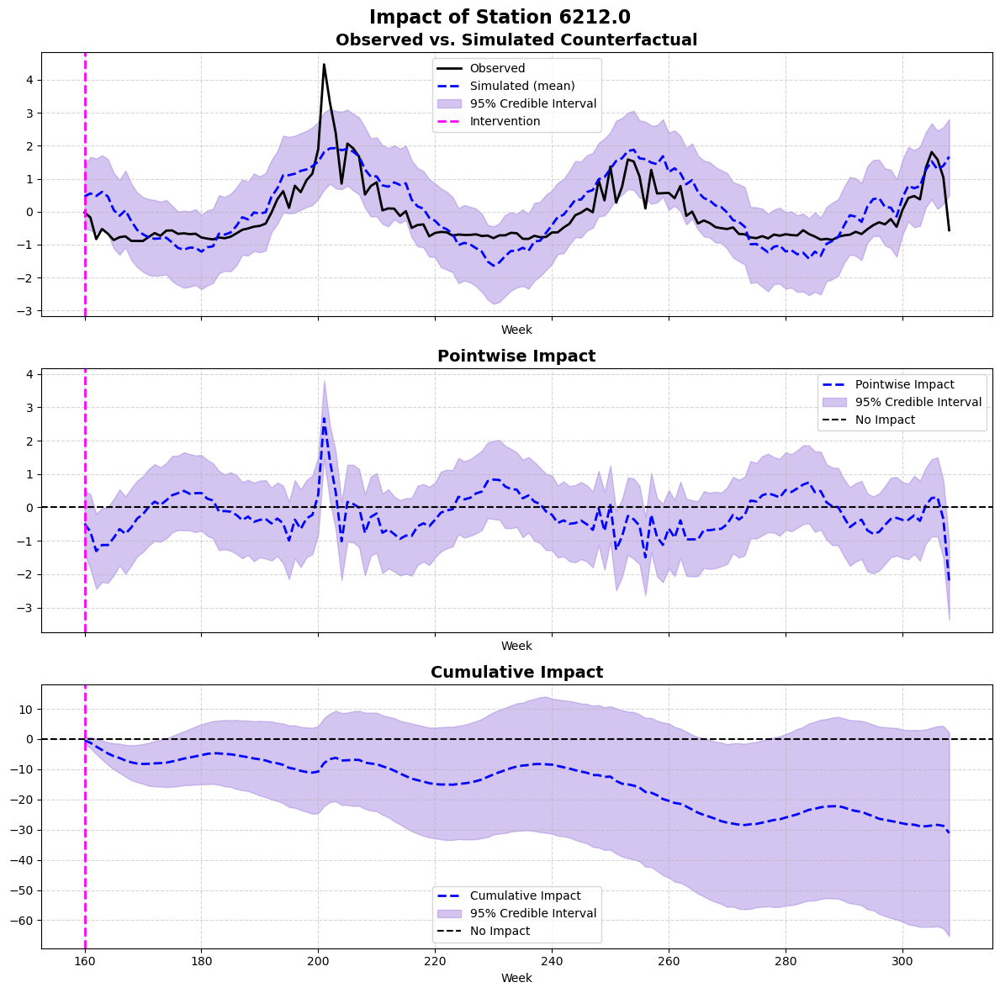

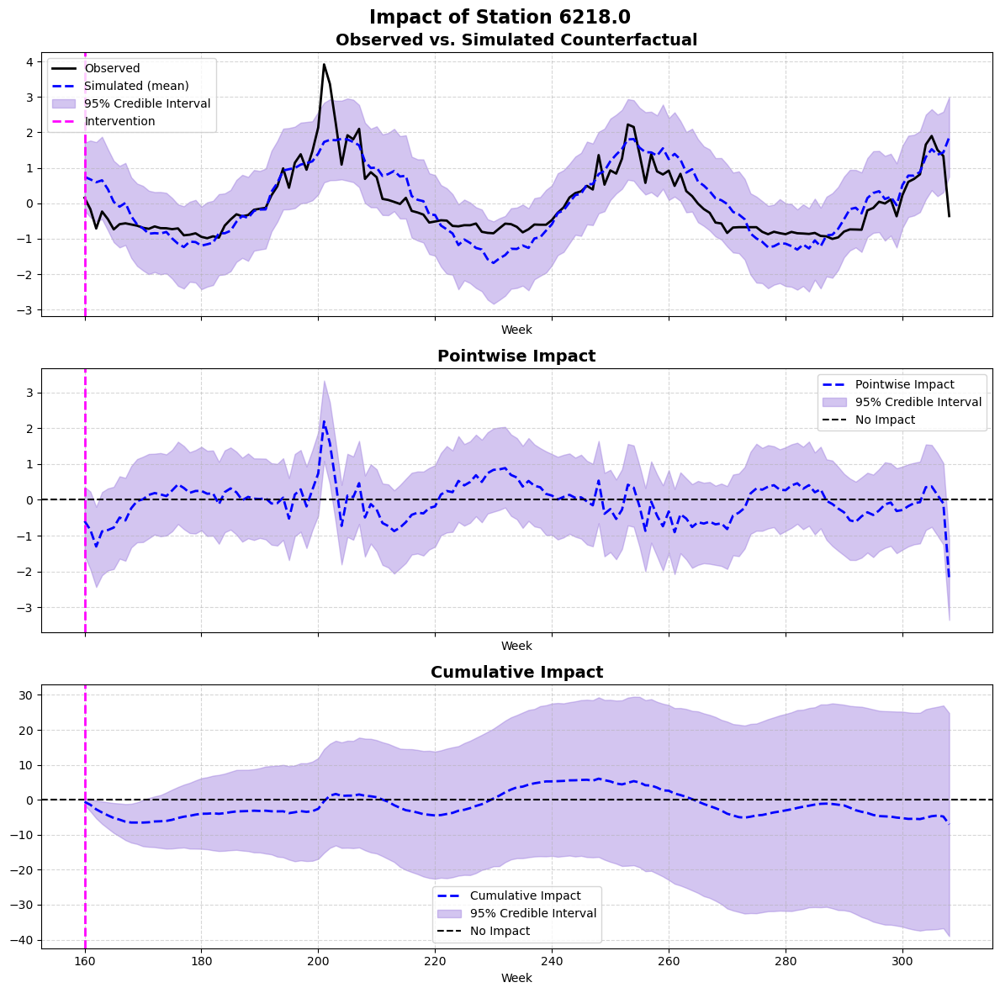

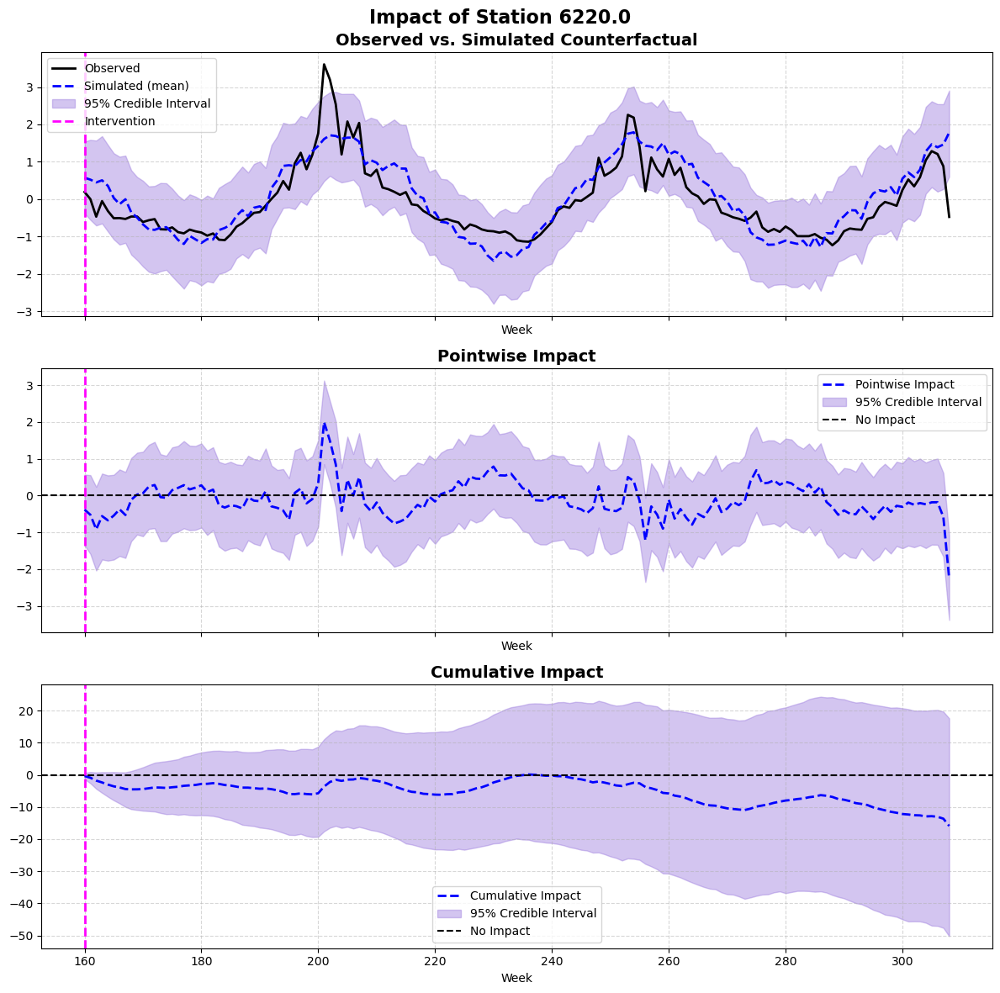

...

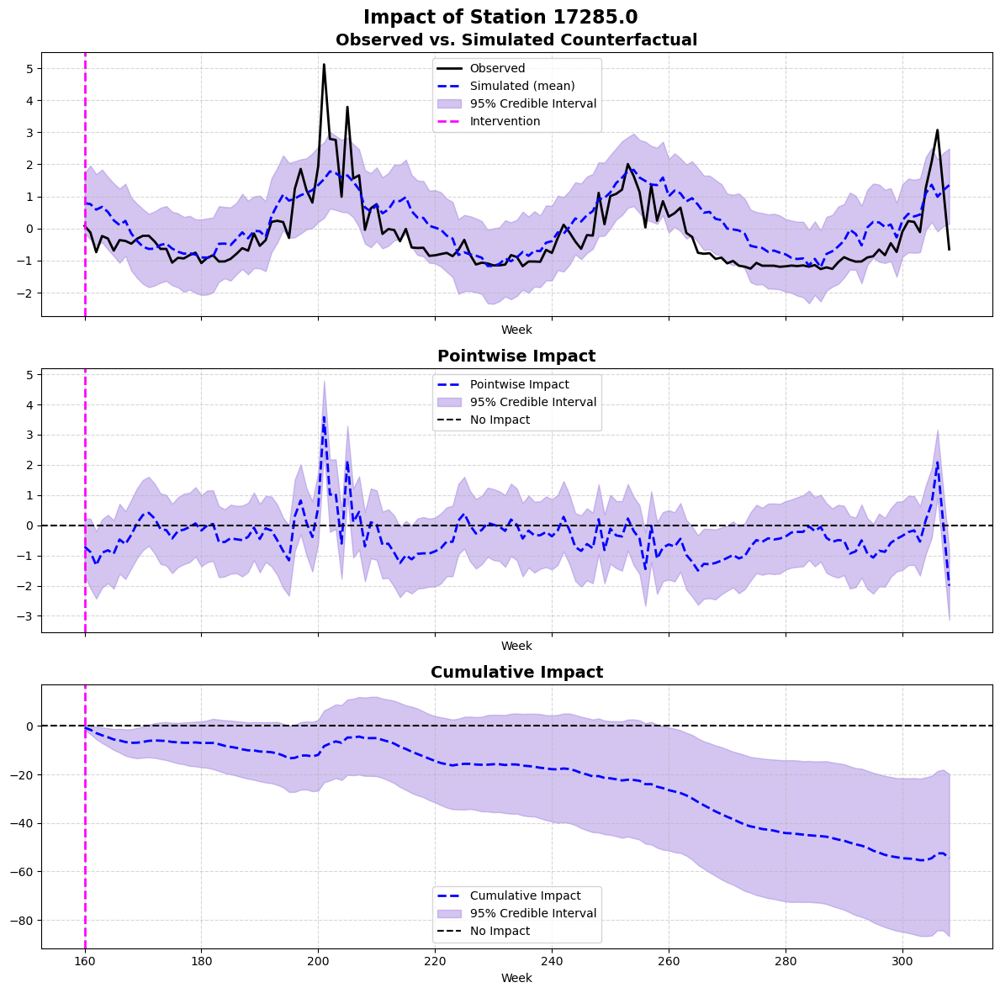

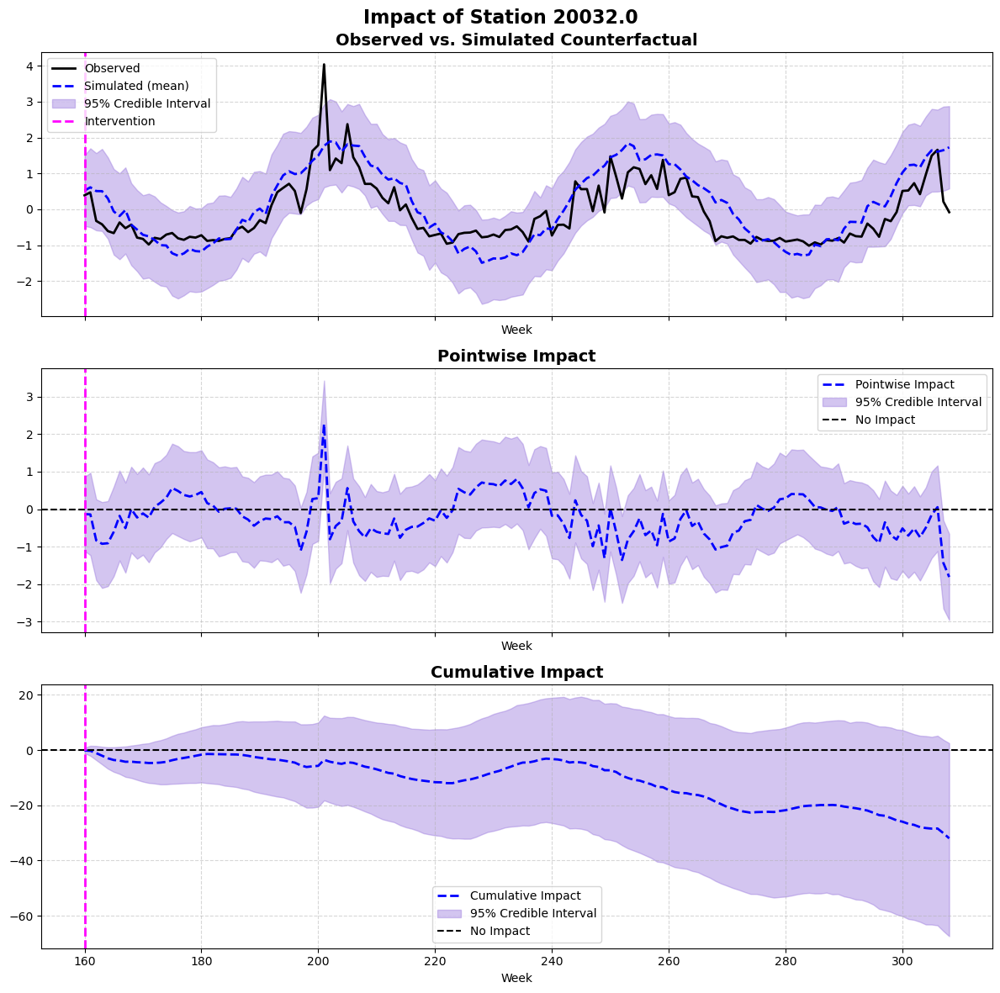

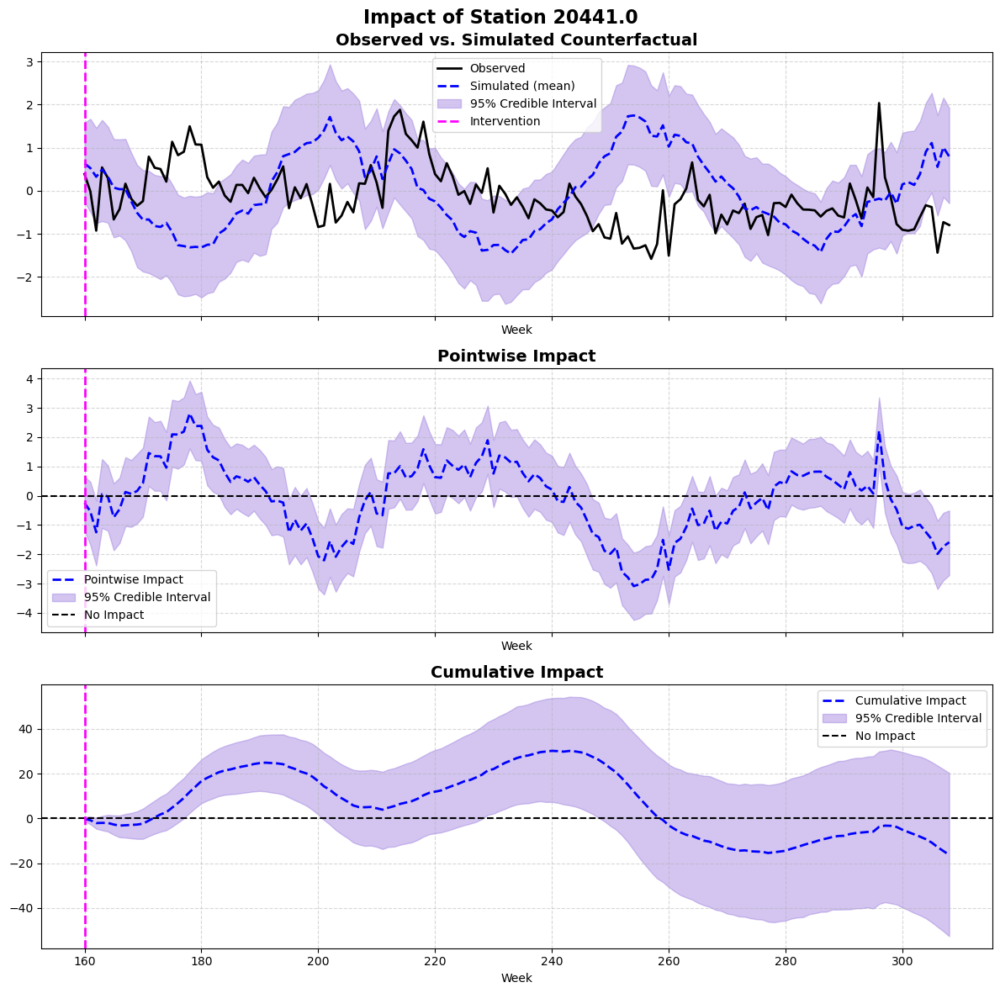

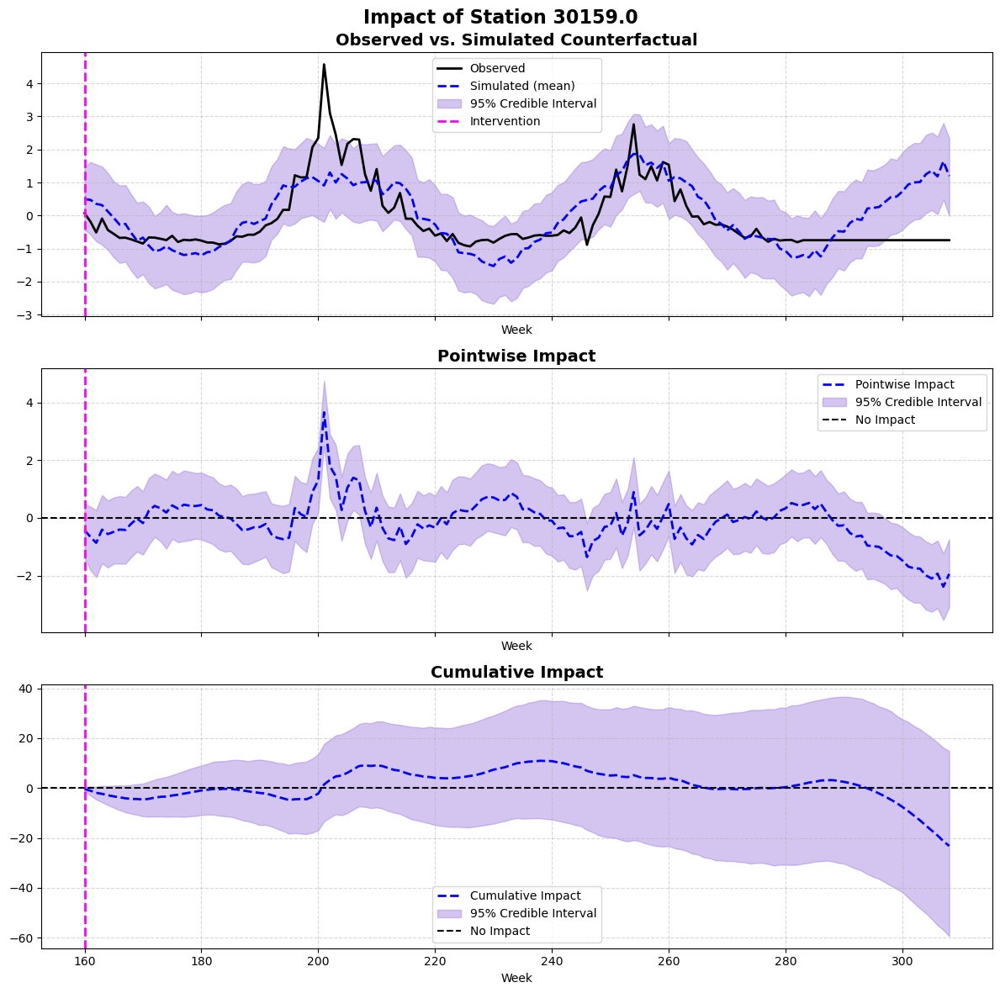

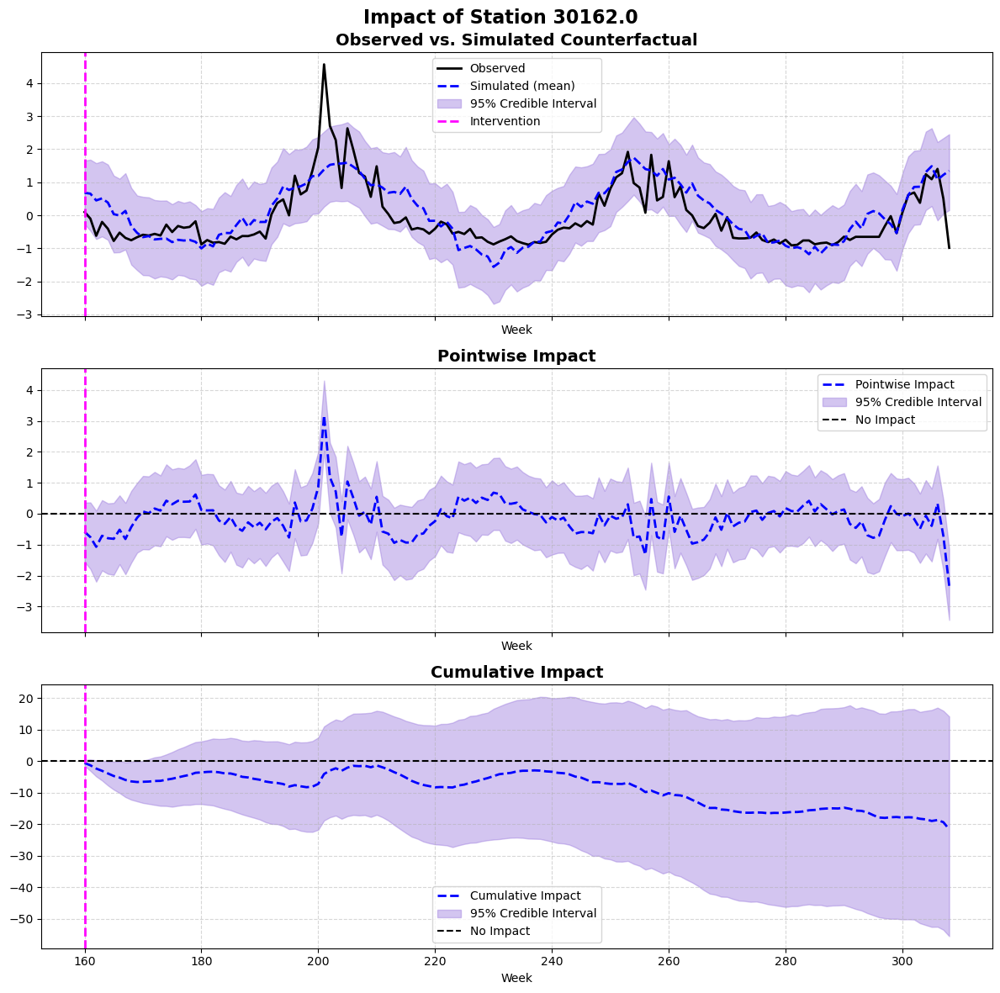

In [ ]:
# Extraction of sensor IDs
sensor_ids = y_normalized.index.tolist()

# Extraction of simulated values (post-intervention)
posterior_y_sim = fit.stan_variable("y_sim")

# Extraction of pointwise impact (Post - intervention)
posterior_point_impact = fit.stan_variable("impact")

# Computation of the cumulative impact for each station
posterior_cumulative_impact = np.cumsum(posterior_point_impact, axis=2)

# Computation of median and credible intervals for each of the previous
y_sim_median = np.median(posterior_y_sim, axis=0)
y_sim_low = np.percentile(posterior_y_sim, 2.5, axis=0)
y_sim_high = np.percentile(posterior_y_sim, 97.5, axis=0)

point_impact_median = np.median(posterior_point_impact, axis=0)
point_impact_low = np.percentile(posterior_point_impact, 2.5, axis=0)
point_impact_high = np.percentile(posterior_point_impact, 97.5, axis=0)

cumulative_impact_median = np.median(posterior_cumulative_impact, axis=0)
cumulative_impact_low = np.percentile(posterior_cumulative_impact, 2.5, axis=0)
cumulative_impact_high = np.percentile(posterior_cumulative_impact, 97.5, axis=0)

# Plot of post - intervention effects for each station
for i, sensor_id in enumerate(sensor_ids):
    fig, axes = plt.subplots(3, 1, figsize=(12, 12), sharex=True)
    fig.suptitle(f"Impact of Station {sensor_id}", fontsize=16, fontweight="bold")

    # Simulated vs Real
    axes[0].plot(range(T0, T), y_normalized.values[i, T0:T],
                 label="Observed", color="black", linewidth=2)
    axes[0].plot(range(T0, T), y_sim_median[i, :],
                 label="Simulated (mean)", color="blue", linestyle="dashed", linewidth=2)
    axes[0].fill_between(range(T0, T), y_sim_low[i, :], y_sim_high[i, :],
                         color="mediumpurple", alpha=0.4, label="95% Credible Interval")
    axes[0].axvline(x=T0, color="magenta", linestyle="--", linewidth=2, label="Intervention")
    axes[0].set_title("Observed vs. Simulated Counterfactual", fontsize=14, fontweight="bold")
    axes[0].legend()

    # Pointwise Impact
    axes[1].plot(range(T0, T), point_impact_median[i, :],
                 label="Pointwise Impact", color="blue", linestyle="dashed", linewidth=2)
    axes[1].fill_between(range(T0, T), point_impact_low[i, :], point_impact_high[i, :],
                         color="mediumpurple", alpha=0.4, label="95% Credible Interval")
    axes[1].axhline(y=0, color="black", linestyle="--", linewidth=1.5, label="No Impact")
    axes[1].axvline(x=T0, color="magenta", linestyle="--", linewidth=2)
    axes[1].set_title("Pointwise Impact", fontsize=14, fontweight="bold")
    axes[1].legend()

    # Cumulative Impact
    axes[2].plot(range(T0, T), cumulative_impact_median[i, :],
                 label="Cumulative Impact", color="blue", linestyle="dashed", linewidth=2)
    axes[2].fill_between(range(T0, T), cumulative_impact_low[i, :], cumulative_impact_high[i, :],
                         color="mediumpurple", alpha=0.4, label="95% Credible Interval")
    axes[2].axhline(y=0, color="black", linestyle="--", linewidth=1.5, label="No Impact")
    axes[2].axvline(x=T0, color="magenta", linestyle="--", linewidth=2)
    axes[2].set_title("Cumulative Impact", fontsize=14, fontweight="bold")
    axes[2].legend()

    for ax in axes:
        ax.grid(True, linestyle="--", alpha=0.5)
        ax.set_xlabel("Week")

    plt.tight_layout()
    plt.show()

In [ ]:
print(cumulative_impact_median.shape)   # Mediana
print(cumulative_impact_low.shape)  # 5%
print(cumulative_impact_high.shape)  # 95%



dff1 = pd.DataFrame(cumulative_impact_median)
dff2 = pd.DataFrame(cumulative_impact_low)
dff3 = pd.DataFrame(cumulative_impact_high)



merged_med = pd.concat([dff1, coords.reset_index(drop=True)], axis=1)
merged_low = pd.concat([dff2, coords.reset_index(drop=True)], axis=1)
merged_high = pd.concat([dff3, coords.reset_index(drop=True)], axis=1)

merged_high.to_csv('high.csv')
merged_low.to_csv('low.csv')
merged_med.to_csv('med.csv')

(83, 149)
(83, 149)
(83, 149)
